# California Housing Project

This notebook explores the california housing price datasets. It explores the use of Machine learning to predict house prices.

## Importing Libraries

In [1]:
# import libraries necessary for this project
import numpy as np # for mathematical
import pandas as pd # for data processing
import seaborn as sns #for statistical data visualization 
import matplotlib.pyplot as plt # for data visualization and plotting

#import supplementary libraries
import warnings
warnings.filterwarnings('ignore')

#for pretty plots on notebooks
%matplotlib inline 

These are the key libraries we will use, the rest will be imported later on.

## Fetch the Data

We can fetch the data for this project from scikit-learn:

In [2]:
from sklearn.datasets import fetch_california_housing

In [3]:
california_housing = fetch_california_housing(as_frame=True)

In [4]:
#get the description of the data
print(california_housing.DESCR)

.. _california_housing_dataset:

California Housing dataset
--------------------------

**Data Set Characteristics:**

    :Number of Instances: 20640

    :Number of Attributes: 8 numeric, predictive attributes and the target

    :Attribute Information:
        - MedInc        median income in block group
        - HouseAge      median house age in block group
        - AveRooms      average number of rooms per household
        - AveBedrms     average number of bedrooms per household
        - Population    block group population
        - AveOccup      average number of household members
        - Latitude      block group latitude
        - Longitude     block group longitude

    :Missing Attribute Values: None

This dataset was obtained from the StatLib repository.
https://www.dcc.fc.up.pt/~ltorgo/Regression/cal_housing.html

The target variable is the median house value for California districts,
expressed in hundreds of thousands of dollars ($100,000).

This dataset was derived

## Exploratory Data Analysis

### Data Visualization

In [5]:
#check the an overview of the entire dataset by printing the first 5 line of the data
california_housing.frame.head()

,MedInc,HouseAge,AveRooms,AveBedrms,Population,AveOccup,Latitude,Longitude,MedHouseVal
0,8.3252,41.0,6.984127,1.023810,322.0,2.555556,37.88,-122.23,4.526
1,8.3014,21.0,6.238137,0.971880,2401.0,2.109842,37.86,-122.22,3.585
2,7.2574,52.0,8.288136,1.073446,496.0,2.802260,37.85,-122.24,3.521
3,5.6431,52.0,5.817352,1.073059,558.0,2.547945,37.85,-122.25,3.413
4,3.8462,52.0,6.281853,1.081081,565.0,2.181467,37.85,-122.25,3.422


In [6]:
# Initializing the dataframe
data = pd.DataFrame(california_housing.data)

In [7]:
#check the overview of the dataframe
data.head()

,MedInc,HouseAge,AveRooms,AveBedrms,Population,AveOccup,Latitude,Longitude
0,8.3252,41.0,6.984127,1.023810,322.0,2.555556,37.88,-122.23
1,8.3014,21.0,6.238137,0.971880,2401.0,2.109842,37.86,-122.22
2,7.2574,52.0,8.288136,1.073446,496.0,2.802260,37.85,-122.24
3,5.6431,52.0,5.817352,1.073059,558.0,2.547945,37.85,-122.25
4,3.8462,52.0,6.281853,1.081081,565.0,2.181467,37.85,-122.25


This allows us to see the features that will be used by the prediction models. `MedHouseVal` is our target variable thus cannot be used in prediction.

We can check the first few target variables:

In [8]:
#checking the first 10 inputs of the target variable
california_housing.target.head(10)

0    4.526
1    3.585
2    3.521
3    3.413
4    3.422
5    2.697
6    2.992
7    2.414
8    2.267
9    2.611
Name: MedHouseVal, dtype: float64

We can therefore conclude that this is a regression problem as we have a target variable which is the median of the house value for each district in California. A regression problem is a supervised learning task that predicts a continuous or numerical value based on input features by learning how the target variable(dependent variable) relates to the input variables. The output from the regression models is a numerical value that is evaluated against performance metrics like mean squared error (MSE), root mean squared error (RMSE), mean absolute error (MAE), or R-squared.

Now, we check more into details the data types and if the dataset contains any missing value:

In [9]:
california_housing.frame.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 20640 entries, 0 to 20639
Data columns (total 9 columns):
 #   Column       Non-Null Count  Dtype  
---  ------       --------------  -----  
 0   MedInc       20640 non-null  float64
 1   HouseAge     20640 non-null  float64
 2   AveRooms     20640 non-null  float64
 3   AveBedrms    20640 non-null  float64
 4   Population   20640 non-null  float64
 5   AveOccup     20640 non-null  float64
 6   Latitude     20640 non-null  float64
 7   Longitude    20640 non-null  float64
 8   MedHouseVal  20640 non-null  float64
dtypes: float64(9)
memory usage: 1.4 MB


This shows us the information on the whole dataset. We can conclude that:  
1) The dataset has 20640 inputs and 8 features.
2) The dataset is made of values of float type
3) The dataset has no missing values.


In [10]:
#check for a summary of the data
data.describe()

,MedInc,HouseAge,AveRooms,AveBedrms,Population,AveOccup,Latitude,Longitude
count,20640.000000,20640.000000,20640.000000,20640.000000,20640.000000,20640.000000,20640.000000,20640.000000
mean,3.870671,28.639486,5.429000,1.096675,1425.476744,3.070655,35.631861,-119.569704
std,1.899822,12.585558,2.474173,0.473911,1132.462122,10.386050,2.135952,2.003532
min,0.499900,1.000000,0.846154,0.333333,3.000000,0.692308,32.540000,-124.350000
25%,2.563400,18.000000,4.440716,1.006079,787.000000,2.429741,33.930000,-121.800000
50%,3.534800,29.000000,5.229129,1.048780,1166.000000,2.818116,34.260000,-118.490000
75%,4.743250,37.000000,6.052381,1.099526,1725.000000,3.282261,37.710000,-118.010000
max,15.000100,52.000000,141.909091,34.066667,35682.000000,1243.333333,41.950000,-114.310000


This shows a summary for the data.   
Now we can start looking at how the data appears by plotting it on graphs:

array([[<Axes: title={'center': 'MedInc'}>,
        <Axes: title={'center': 'HouseAge'}>,
        <Axes: title={'center': 'AveRooms'}>],
       [<Axes: title={'center': 'AveBedrms'}>,
        <Axes: title={'center': 'Population'}>,
        <Axes: title={'center': 'AveOccup'}>],
       [<Axes: title={'center': 'Latitude'}>,
        <Axes: title={'center': 'Longitude'}>, <Axes: >]], dtype=object)

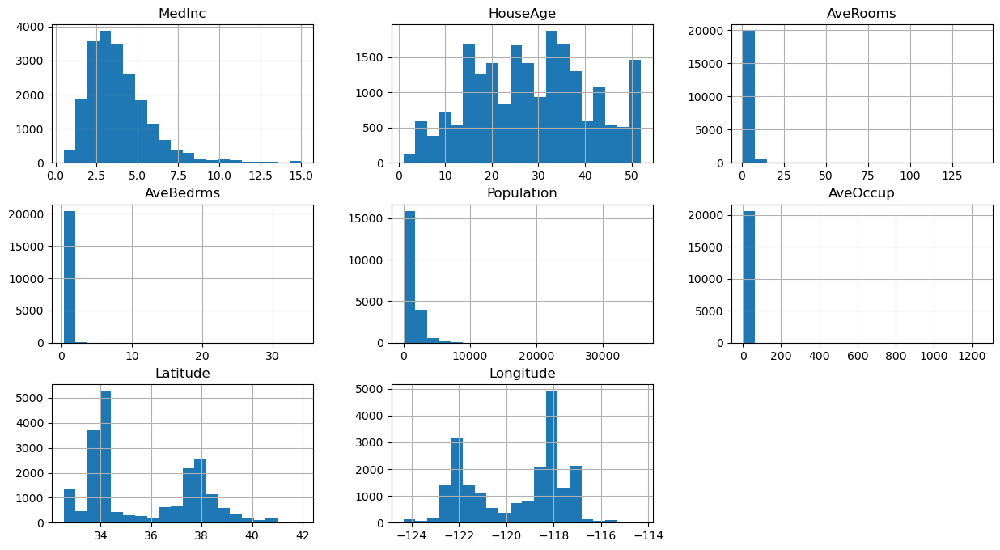

In [11]:
data.hist(figsize=(15, 8), bins=20)

In [12]:
mean_data = []
for i in data.columns:
    mean_data.append(np.ceil(np.mean(data[str(i)])))

In [13]:
stdev_data = []
for i in data.columns:
    stdev_data.append(np.ceil(np.std(data[str(i)])))

In [14]:
# mean of data per column
mean_data

[4.0, 29.0, 6.0, 2.0, 1426.0, 4.0, 36.0, -119.0]

In [15]:
# standard deviation of the data per column
stdev_data

[2.0, 13.0, 3.0, 1.0, 1133.0, 11.0, 3.0, 3.0]

Now we can plot the mean and standard deviation of the column data in a graph:

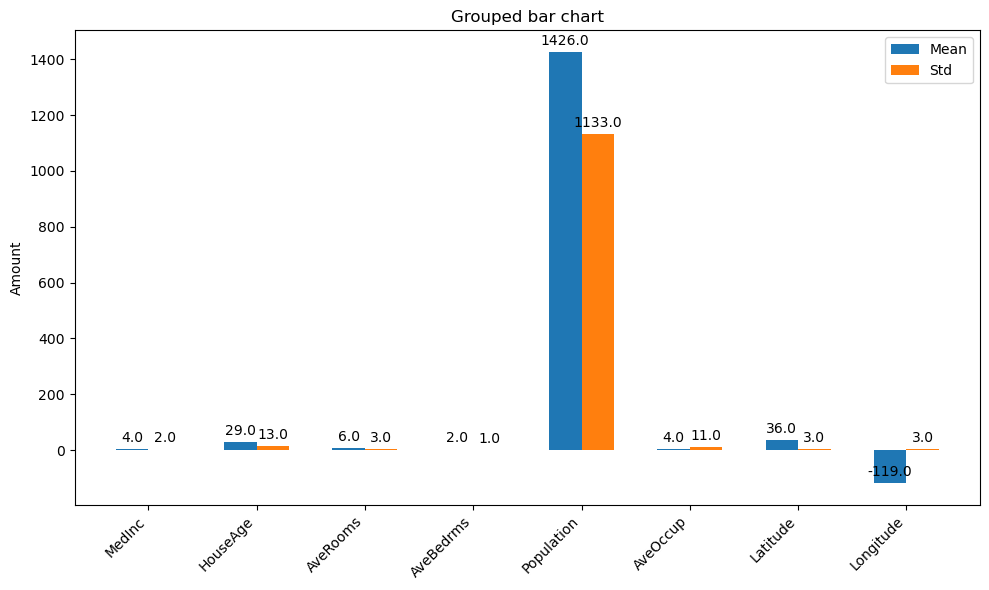

In [16]:
import numpy as np
import matplotlib.pyplot as plt

labels = data.columns
mean_data;  #  mean values of the data
stdev_data; #  standard deviation values of the data

x = np.arange(len(labels))
width = 0.3  # the width of the bars

fig, ax = plt.subplots(figsize=(10, 6))  # Increase the figure size as needed

rects1 = ax.bar(x - width/2, mean_data, width, label='Mean')
rects2 = ax.bar(x + width/2, stdev_data, width, label='Std')

ax.set_ylabel('Amount')
ax.set_title('Grouped bar chart')
ax.set_xticks(x)
ax.set_xticklabels(labels, rotation=45, ha='right')  # Rotate the labels and align them to the right
ax.legend()

def autolabel(rects):
    """Attach a text label above each bar in *rects*, displaying its height."""
    for rect in rects:
        height = rect.get_height()
        ax.annotate('{}'.format(height),
                    xy=(rect.get_x() + rect.get_width() / 2, height),
                    xytext=(0, 3),  # 3 points vertical offset
                    textcoords="offset points",
                    ha='center', va='bottom')

autolabel(rects1)
autolabel(rects2)

fig.tight_layout()

plt.show()

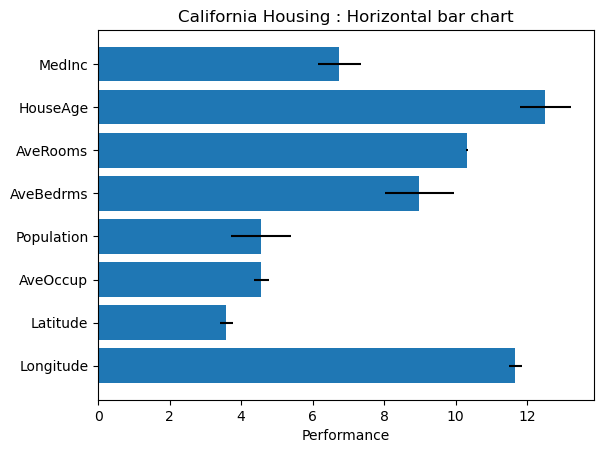

In [17]:
np.random.seed(42)   # Set the random seed for reproducibility

plt.rcdefaults()  # Restore the default matplotlib settings
fig, ax = plt.subplots()  # Create a figure and axis objects


labels = data.columns  #Set the labels for the y-axis
y_pos = np.arange(len(labels))  # Create an array of y-axis positions
performance = 3 + 10 * np.random.rand(len(labels))  # Generate random performance values
error = np.random.rand(len(labels))  # Generate random error values

ax.barh(y_pos, performance, xerr=error, align='center')  # Create a horizontal bar chart
ax.set_yticks(y_pos)   #Set the y-axis tick positions
ax.set_yticklabels(labels) # Set the y-axis tick labels
ax.invert_yaxis()   # Invert the y-axis to have labels read from top to bottom
ax.set_xlabel('Performance')  # Set the x-axis label
ax.set_title('California Housing : Horizontal bar chart')   # Set the chart title

plt.show()  # Display the plot

The code generates a horizontal bar chart with randomly generated performance values for each label/category on the y-axis.

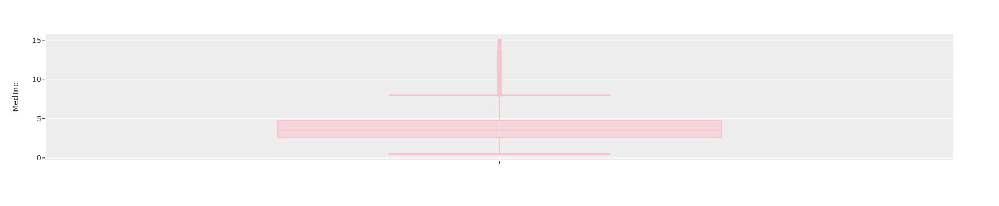

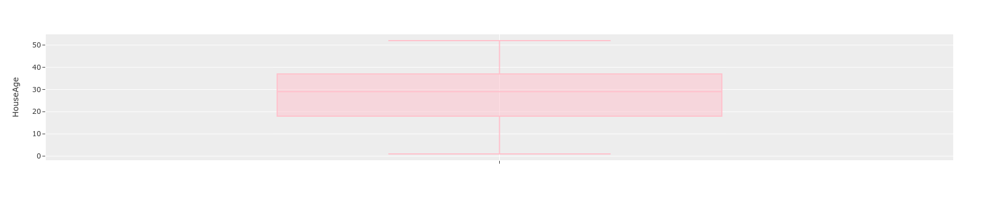

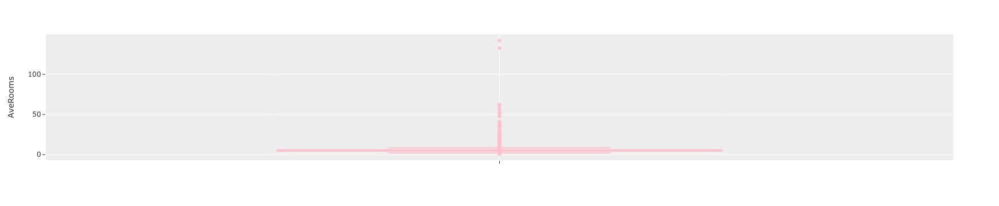

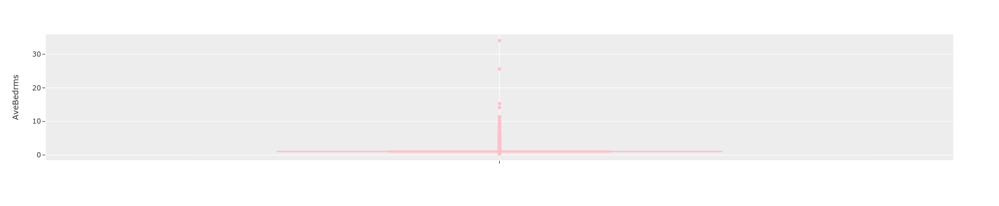

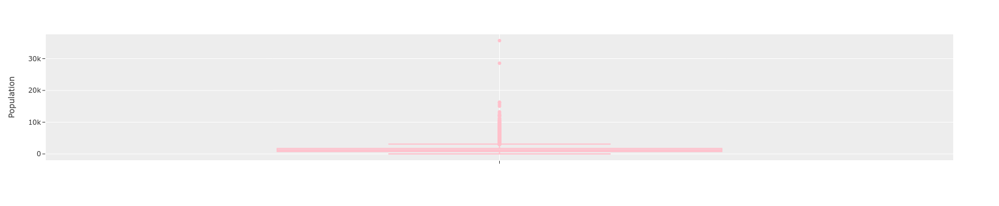

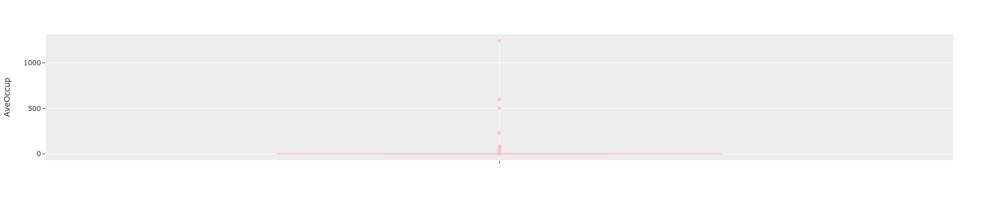

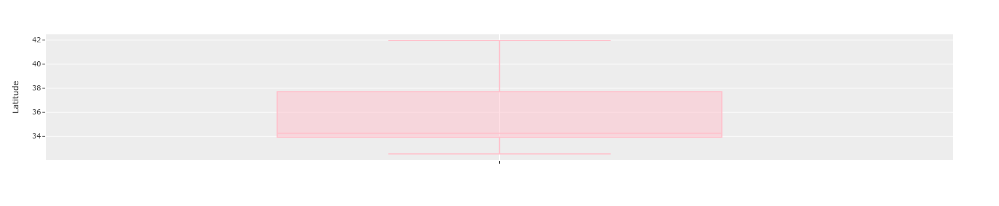

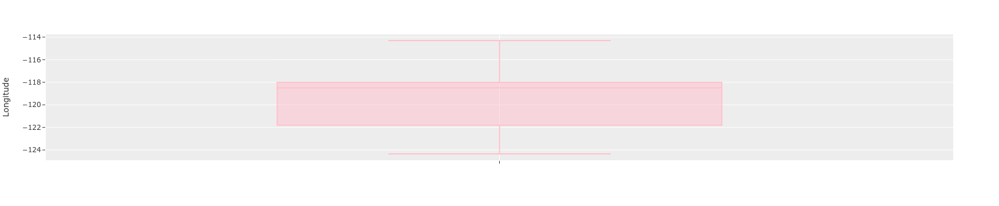

In [18]:
import plotly.express as px #import plotlty.express library for creating interactive visualizations.
# sets up a loop that iterates over each column
for column in data.columns:
    fig = px.box(data_frame=data,y=column,orientation='v', color_discrete_sequence=['pink'], template='ggplot2')  # creates a box plot for the current column
    fig.show()  # displays the plot

This code creates an interactive visualization of the data in the dataframe. From this, we can see the visual representation of data in each column. When you hover the pointer at each graph, it displays the minimum, the lower fence, q1, median, q3, upper fence and maximum values of each data per column.

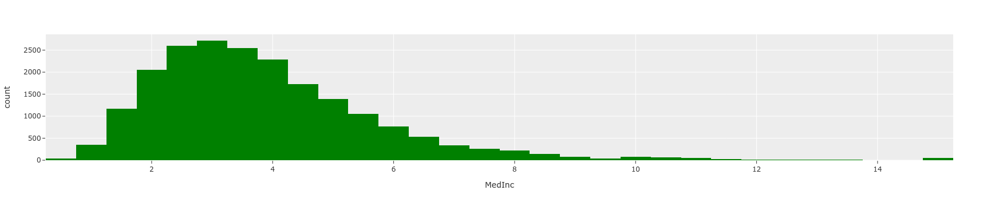

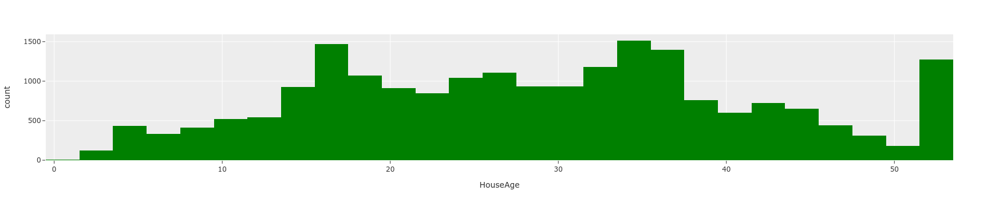

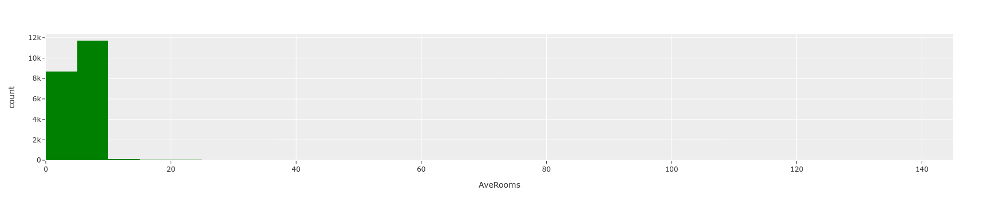

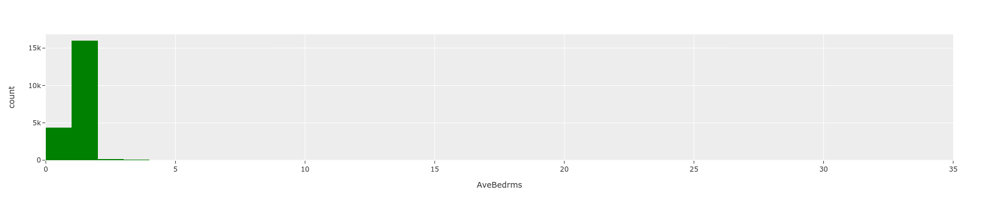

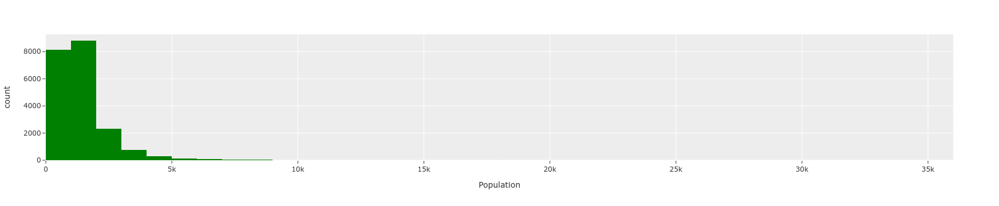

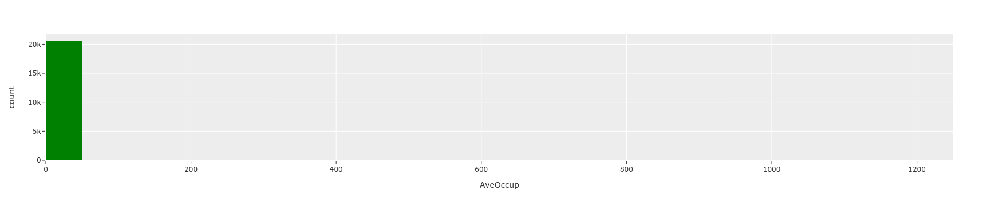

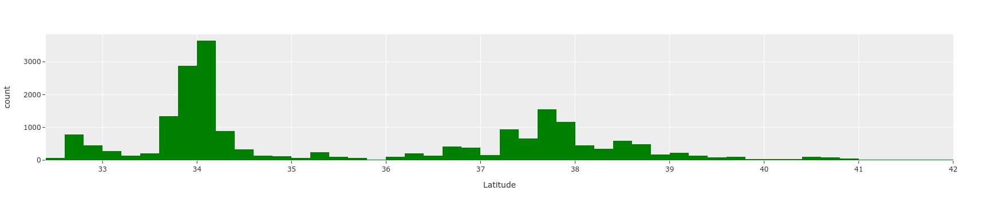

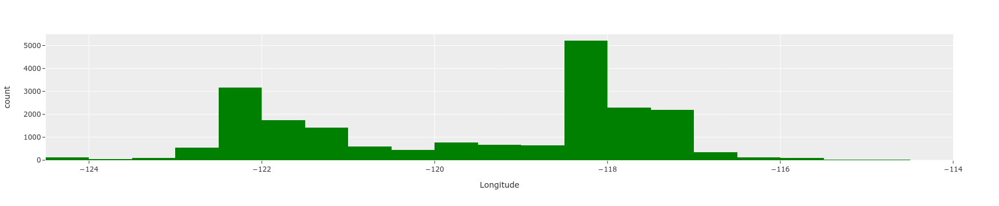

In [19]:
for column in data.columns:
    fig = px.histogram(data_frame=data, x=column, nbins=50, color_discrete_sequence=['green'], template= 'ggplot2')
    fig.show()

The above code essentially generates a series of histograms, with one histogram created for each column in the data. The plotly.express library provides interactive and visually appealing histograms, allowing for exploration and analysis of the data distribution and frequency of each column. 

<Axes: xlabel='Longitude', ylabel='Latitude'>

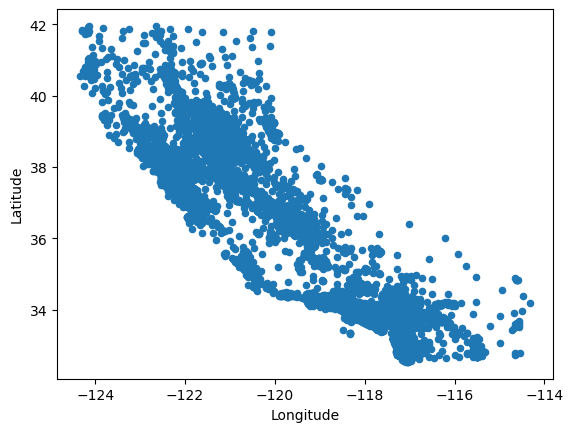

In [20]:
data.plot(kind="scatter",x="Longitude",y="Latitude")

This code creates a scatter plot to explore the spatial distribution or relationship between longitude and latitude coordinates.

<Axes: xlabel='Longitude', ylabel='Latitude'>

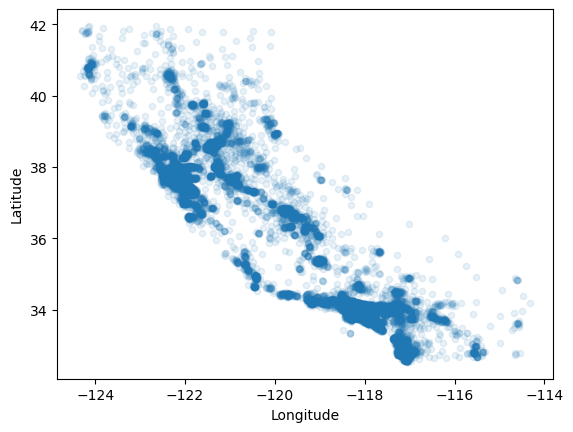

In [21]:
data.plot(kind="scatter",x="Longitude",y="Latitude",alpha=0.1)

By adding `alpha=0.1` to the code, the scatter plot will now have semi-transparent points, allowing for a better visualization of point density and overlap.

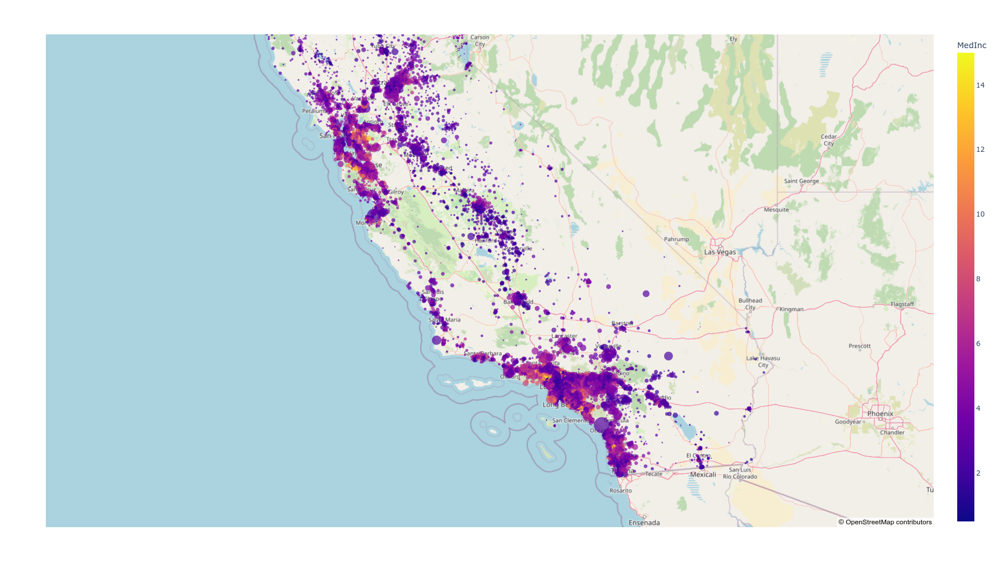

In [22]:
import plotly.offline as py
py.init_notebook_mode(connected=True)
map=px.scatter_mapbox(data,
                      lat='Latitude',
                      lon='Longitude',
                      color='MedInc',
                      size='Population',
                      zoom=6,
                      height=1000)
map.update_layout(mapbox_style='open-street-map')
map.show()

This creates an interactive visual representation of the Longitude, Lattitude, Population and MedInc. If you hover the pointer over the map, it gives you the value of Longitude, Lattitude, Population and MedInc on the map. From this, we can see where the high, medium and low income population reside.

In [23]:
housing = california_housing['data'].join(california_housing['target'])
housing.head()

,MedInc,HouseAge,AveRooms,AveBedrms,Population,AveOccup,Latitude,Longitude,MedHouseVal
0,8.3252,41.0,6.984127,1.023810,322.0,2.555556,37.88,-122.23,4.526
1,8.3014,21.0,6.238137,0.971880,2401.0,2.109842,37.86,-122.22,3.585
2,7.2574,52.0,8.288136,1.073446,496.0,2.802260,37.85,-122.24,3.521
3,5.6431,52.0,5.817352,1.073059,558.0,2.547945,37.85,-122.25,3.413
4,3.8462,52.0,6.281853,1.081081,565.0,2.181467,37.85,-122.25,3.422


Now we can check `MedHouseVal` on the map after we add target to our data:

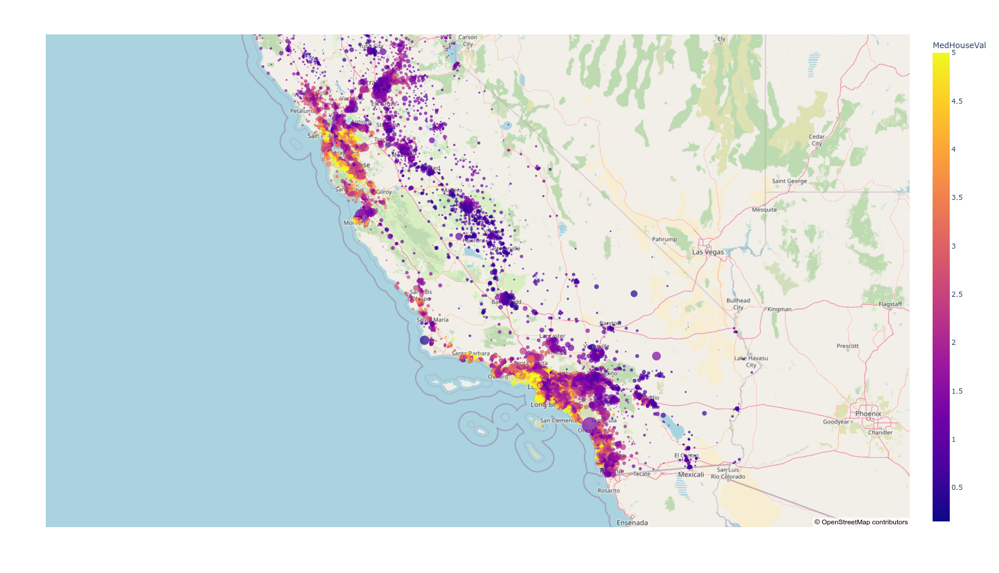

In [24]:
py.init_notebook_mode(connected=True)
map=px.scatter_mapbox(housing,
                      lat='Latitude',
                      lon='Longitude',
                      color='MedHouseVal',
                      size='Population',
                      zoom=6,
                      height=1000)
map.update_layout(mapbox_style='open-street-map')
map.show()

From this, we can see that the two maps are quite different but not very different. So let's check for how the data correlates.

### Data Correlation

We can see all the correlation coefficients for every combination of columns in this dataset by calling `np.corrcoef`:

In [25]:
np.set_printoptions(precision=2, suppress=True)

np.corrcoef(housing, rowvar=False)

array([[ 1.  , -0.12,  0.33, -0.06,  0.  ,  0.02, -0.08, -0.02,  0.69],
       [-0.12,  1.  , -0.15, -0.08, -0.3 ,  0.01,  0.01, -0.11,  0.11],
       [ 0.33, -0.15,  1.  ,  0.85, -0.07, -0.  ,  0.11, -0.03,  0.15],
       [-0.06, -0.08,  0.85,  1.  , -0.07, -0.01,  0.07,  0.01, -0.05],
       [ 0.  , -0.3 , -0.07, -0.07,  1.  ,  0.07, -0.11,  0.1 , -0.02],
       [ 0.02,  0.01, -0.  , -0.01,  0.07,  1.  ,  0.  ,  0.  , -0.02],
       [-0.08,  0.01,  0.11,  0.07, -0.11,  0.  ,  1.  , -0.92, -0.14],
       [-0.02, -0.11, -0.03,  0.01,  0.1 ,  0.  , -0.92,  1.  , -0.05],
       [ 0.69,  0.11,  0.15, -0.05, -0.02, -0.02, -0.14, -0.05,  1.  ]])

Now, we can check for single coefficients:

In [26]:
np.corrcoef(housing.MedInc, housing.MedHouseVal)

array([[1.  , 0.69],
       [0.69, 1.  ]])

Let's create a function that returns a single value:

In [27]:
def corr(x,y): return np.corrcoef(x,y)[0][1]

corr(housing.MedInc, housing.MedHouseVal)

0.6880752079585475

We can look at another:

In [28]:
def corr(x,y): return np.corrcoef(x,y)[0][1]

corr(housing.HouseAge, housing.MedHouseVal)

0.10562341249320994

We can create a heatmap to show these correlations.  
Correlation for the data without the target:

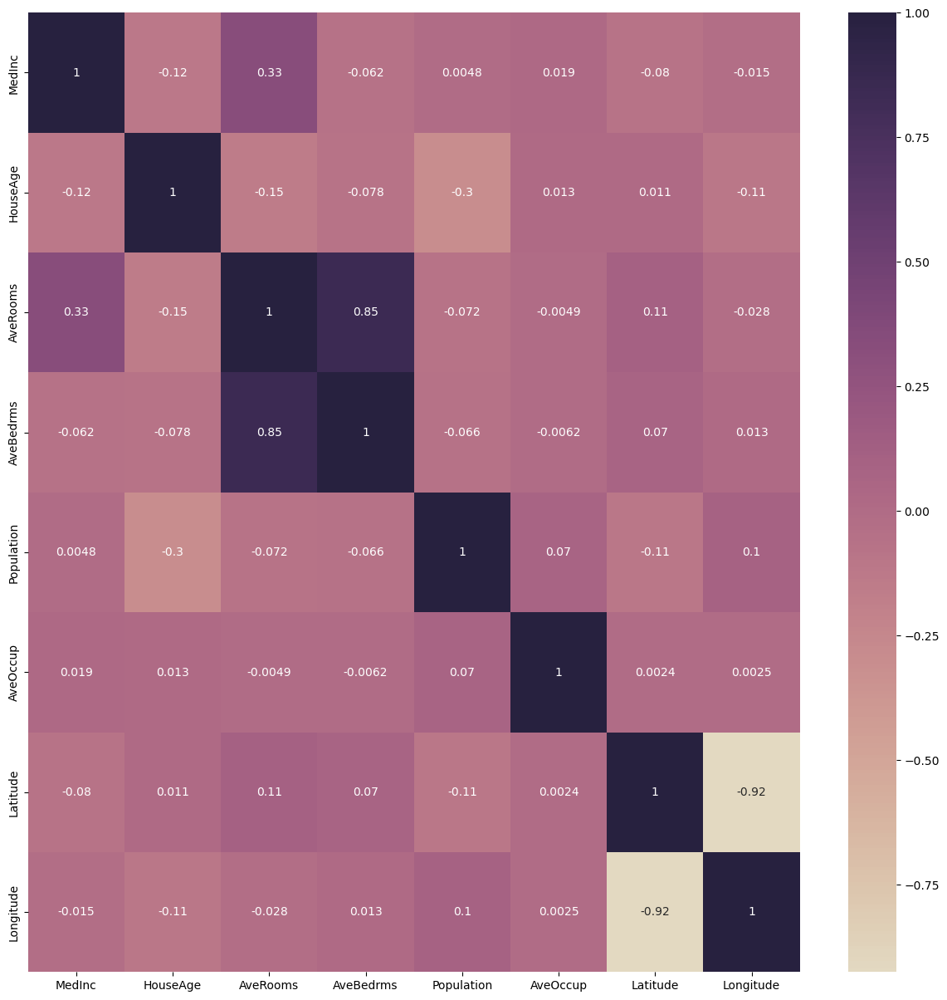

In [29]:
corr = data.corr()
plt.figure(figsize=(15,15))
sns.heatmap(corr, cmap=sns.color_palette("ch:s=-.2,r=.6", as_cmap=True),annot=True)
plt.show()

Correlation plus the target:

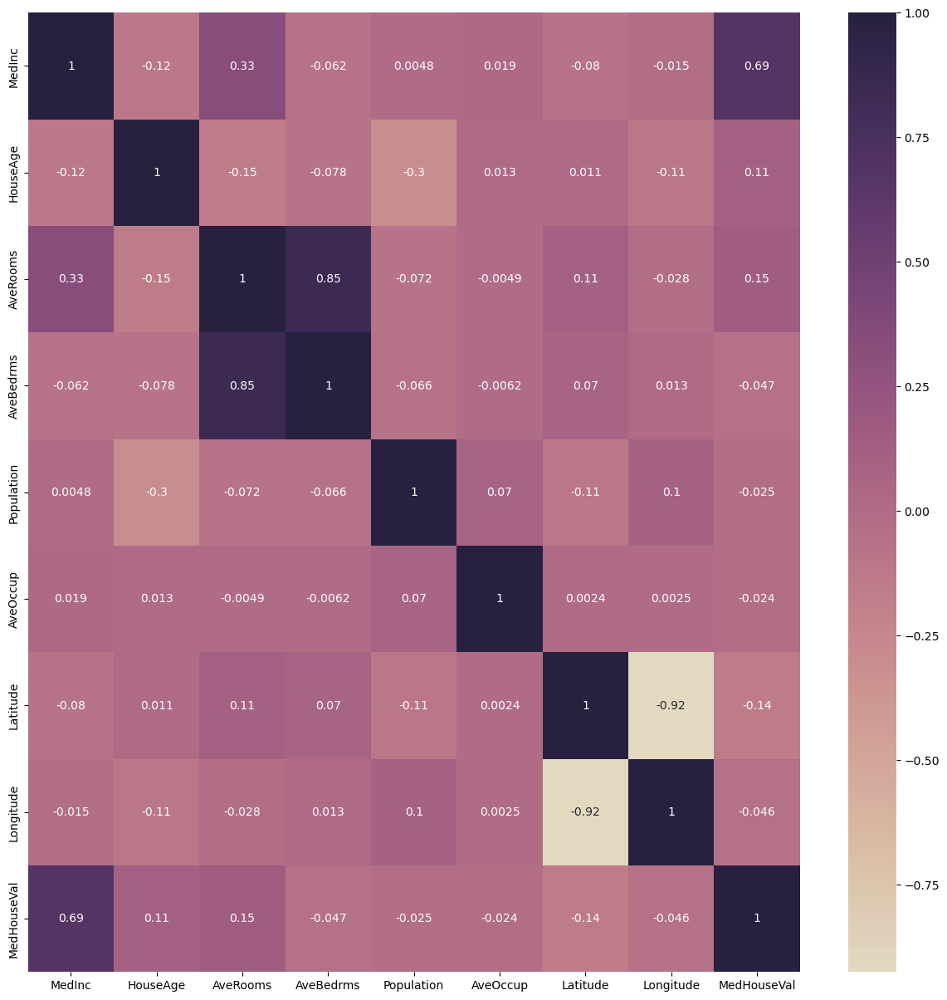

In [30]:
corr = housing.corr()
plt.figure(figsize=(15,15))
sns.heatmap(corr, cmap=sns.color_palette("ch:s=-.2,r=.6", as_cmap=True),annot=True)
plt.show()

Now, we can sort the coeffiecients in as descending order in relation to the target:

In [31]:
corr=housing.corr()
corr["MedHouseVal"].sort_values(ascending=False)

MedHouseVal    1.000000
MedInc         0.688075
AveRooms       0.151948
HouseAge       0.105623
AveOccup      -0.023737
Population    -0.024650
Longitude     -0.045967
AveBedrms     -0.046701
Latitude      -0.144160
Name: MedHouseVal, dtype: float64

## Splitting the Data into Training Set and Test Set

In [32]:
names = data.columns
print(names)

Index(['MedInc', 'HouseAge', 'AveRooms', 'AveBedrms', 'Population', 'AveOccup',
       'Latitude', 'Longitude'],
      dtype='object')


In [33]:
# Set X and y
X = data[names].values
y = housing['MedHouseVal'].values

In [34]:
X.shape

(20640, 8)

In [35]:
y.shape

(20640,)

In [36]:
from sklearn.preprocessing import StandardScaler

# Scale the input features using StandardScaler
scaler = StandardScaler() # Initialize StandardScaler object
X = scaler.fit_transform(X) # Scale the input features and replace the original X with the scaled version

We will us Scikit Learn's Cross Validation for Evaluating the Model.  
K-fold cross-validation is a technique used in machine learning and statistical modeling to assess the performance and generalization ability of a model. It helps to estimate how well the model will perform on unseen data.

Let's create a function to:  
- Split the data into training and test set  
- Fit the models 
- Initialiaze metrics evaluation

In [37]:
# importing the libraries needed
from sklearn.model_selection import train_test_split
from sklearn.metrics import r2_score, mean_absolute_error, mean_squared_error
from sklearn.model_selection import KFold

In [38]:
def train_evaluate_model(model, X, y, n_splits=5, is_nn=False, epochs=20):
    '''
    arguments:
        model -- A scikit-learn estimator instance for regression
        X -- The input features for the model
        y -- The target variable for the model
        n_splits -- The number of folds to use in the KFold cross-validation (default=5)

    Returns:
        a dictionary of evaluation metrics for the model
    '''

    kf = KFold(n_splits=n_splits, shuffle=True, random_state=42)  # Create KFold cross-validator object

    # Initialize lists to store the evaluation metrics
    mse_scores = []  # List to store mean squared error (MSE) scores
    r2_scores = []  # List to store R-squared scores
    mae_scores = []  # List to store mean absolute error (MAE) scores
    rmse_scores = []  # List to store root mean squared error (RMSE) scores
    adj_r2_scores = []  # List to store adjusted R-squared (Adj R2) scores

    # Use K-fold cross-validation to evaluate the model
    for train_index, test_index in kf.split(X, y):
        X_train, y_train = X[train_index], y[train_index]  # Split the data into training and testing sets
        X_test, y_test = X[test_index], y[test_index]

        # Fit the model to the training data
        if is_nn:  # Check if the model is a neural network
            model.fit(X_train, y_train, epochs=epochs, verbose=0)  # Train the neural network
        else:
            model.fit(X_train, y_train)  # Fit the model to the training data

        # Make predictions on the test data
        y_pred = model.predict(X_test)

        # Compute the evaluation metrics
        mse = mean_squared_error(y_test, y_pred)  # Calculate mean squared error
        r2 = r2_score(y_test, y_pred)  # Calculate R-squared score
        mae = mean_absolute_error(y_test, y_pred)  # Calculate mean absolute error

        # Calculate root mean squared error (RMSE)
        rmse = np.sqrt(mse)

        # Calculate adjusted R-squared (Adj R2)
        n_samples, n_features = X.shape
        adj_r2 = 1 - (1 - r2) * (n_samples - 1) / (n_samples - n_features - 1)

        # Append the scores to the lists
        mse_scores.append(mse)
        r2_scores.append(r2)
        mae_scores.append(mae)
        rmse_scores.append(rmse)
        adj_r2_scores.append(adj_r2)

    # Compute the mean of the evaluation metrics
    mse_mean = np.mean(mse_scores)
    r2_mean = np.mean(r2_scores)
    mae_mean = np.mean(mae_scores)
    rmse_mean = np.mean(rmse_scores)
    adj_r2_mean = np.mean(adj_r2_scores)

    # Create a DataFrame to store the evaluation metrics
    eval_df = pd.DataFrame({
        'Mean_Squared_Error': [mse_mean],
        'Root_Mean_Squared_Error': [rmse_mean],
        'R_squared': [r2_mean],
        'Mean_Absolute_Error': [mae_mean],
        'Adjusted_R_squared': [adj_r2_mean]
    })

    return eval_df
  


The code above does the following:  
- Creates a function called `train_evaluate_model` that take the following arguments:  
1) Model to be trained and evaluated  
2) X - input features
3) y - target variable
4) n_splits - number of folds for cross-validation
5) is_nn - flag indicating if the model is a neural network
6) epochs - number of epochs for neural network training
This function returns a DataFrame containing evaluation metrics for the model

-  Creates a KFold cross-validator object with the specified number of splits, shuffling the data and setting a random state for reproducibility.  

- Initializes lists for evaluation metrics:  
1) mse_scores = []: List to store mean squared error (MSE) scores for each fold.
2) r2_scores = []: List to store R-squared scores for each fold.
3) mae_scores = []: List to store mean absolute error (MAE) scores  

- Creates a K-fold cross-validation loop:   
1) The loop iterates through the training and testing indices generated by `kf.split(X, y)`.  
2) The input features and target variable are split into training and testing sets `(X_train, y_train, X_test, y_test)`.  
3) The model is fit to the training data using `model.fit()`.  
4) If `is_nn is True`,a neural network, the model is trained for the specified number of epochs.  
5) Predictions are made on the test data using `model.predict()`.  
6) Evaluation metrics (MSE, MAE and R-squared) are calculated using `mean_squared_error()`, `mean_absolute_error()` and `r2_score()`  

- Appends evaluation scores to lists  
1) mse_scores.append(mse) adds the MSE score to the mse_scores list.
2) r2_scores.append(r2) adds the R-squared score to the r2_scores list.
3) mae_scores.append(mae) adds the MAE score to the mae_scores list

- Computes mean and standard deviation of evaluation metrics:  
1) mse_mean = np.mean(mse_scores) calculates the mean of the MSE scores.  
2) mse_std = np.std(mse_scores) calculates the standard deviation of the MSE scores.  
3) r2_mean = np.mean(r2_scores) calculates the mean of the R-squared scores.  
4) r2_std = np.std(r2_scores) calculates the standard deviation of the R-squared scores.  
5) mae_mean = np.mean(mae_scores) calculates the mean of the MAE scores.  
2) mae_std = np.std(mae_scores) calculates the standard deviation of the MAE scores. 

- Lastly, create a DataFrame to store evaluation metrics

## Training the Models

### Linear Regression

In [39]:
from sklearn.linear_model import LinearRegression

lr = LinearRegression()
results = train_evaluate_model(lr, X, y, 10)
results.index = ['LinearRegression']

In [40]:
results.sort_values(by='Mean_Squared_Error',ascending=True).style.background_gradient(cmap = sns.color_palette("ch:s=-.2,r=.6", as_cmap=True))

,Mean_Squared_Error,Root_Mean_Squared_Error,R_squared,Mean_Absolute_Error,Adjusted_R_squared
LinearRegression,0.532527,0.729336,0.600075,0.532031,0.599920


### Decision Tree

In [41]:
from sklearn.tree import DecisionTreeRegressor

decision_tree = DecisionTreeRegressor()
decision_tree_results = train_evaluate_model(decision_tree, X, y, 10)

decision_tree_results.index = ['DecisionTree']

results = results.append(decision_tree_results)

In [42]:
results.sort_values(by='Mean_Squared_Error',ascending=True).style.background_gradient(cmap = sns.color_palette("ch:s=-.2,r=.6", as_cmap=True))

,Mean_Squared_Error,Root_Mean_Squared_Error,R_squared,Mean_Absolute_Error,Adjusted_R_squared
DecisionTree,0.519188,0.720265,0.610030,0.458058,0.609879
LinearRegression,0.532527,0.729336,0.600075,0.532031,0.599920


### KNearestNeighbors

In [43]:
from sklearn.neighbors import KNeighborsRegressor

KNN = KNeighborsRegressor(n_neighbors=7)
knn = train_evaluate_model(KNN, X, y, 10)
knn.index =['KNearsNeighbors']
results = results.append(knn)

In [44]:
results.sort_values(by='Mean_Squared_Error',ascending=True).style.background_gradient(cmap = sns.color_palette("ch:s=-.2,r=.6", as_cmap=True))

,Mean_Squared_Error,Root_Mean_Squared_Error,R_squared,Mean_Absolute_Error,Adjusted_R_squared
KNearsNeighbors,0.402846,0.634362,0.697481,0.432181,0.697363
DecisionTree,0.519188,0.720265,0.610030,0.458058,0.609879
LinearRegression,0.532527,0.729336,0.600075,0.532031,0.599920


### Random Forest Regressor

In [45]:
from sklearn.ensemble import RandomForestRegressor

rfr= RandomForestRegressor()
rfr_result = train_evaluate_model(rfr, X, y, 10)
rfr_result.index = ['RandomForest']

results = results.append(rfr_result)

In [46]:
results.sort_values(by='Mean_Squared_Error',ascending=True).style.background_gradient(cmap = sns.color_palette("ch:s=-.2,r=.6", as_cmap=True))

,Mean_Squared_Error,Root_Mean_Squared_Error,R_squared,Mean_Absolute_Error,Adjusted_R_squared
RandomForest,0.249388,0.499102,0.812705,0.324266,0.812632
KNearsNeighbors,0.402846,0.634362,0.697481,0.432181,0.697363
DecisionTree,0.519188,0.720265,0.610030,0.458058,0.609879
LinearRegression,0.532527,0.729336,0.600075,0.532031,0.599920


### Support Vector Machine(SVM) Regressor

In [47]:
from sklearn.svm import SVR

svm_model = SVR()
svm_results = train_evaluate_model(svm_model, X, y, 10)
svm_results.index = ['SupportVectorMachine']

results = results.append(svm_results)

In [48]:
results.sort_values(by='Mean_Squared_Error',ascending=True).style.background_gradient(cmap = sns.color_palette("ch:s=-.2,r=.6", as_cmap=True))

,Mean_Squared_Error,Root_Mean_Squared_Error,R_squared,Mean_Absolute_Error,Adjusted_R_squared
RandomForest,0.249388,0.499102,0.812705,0.324266,0.812632
SupportVectorMachine,0.344464,0.586530,0.741404,0.390604,0.741303
KNearsNeighbors,0.402846,0.634362,0.697481,0.432181,0.697363
DecisionTree,0.519188,0.720265,0.610030,0.458058,0.609879
LinearRegression,0.532527,0.729336,0.600075,0.532031,0.599920


### XG Boost

In [49]:
import xgboost as xgb

xgboost = xgb.XGBRegressor()
xgboost_result = train_evaluate_model(xgboost, X, y, 10)
xgboost_result.index = ['XGBoost']

results = results.append(xgboost_result)

In [50]:
results.sort_values(by='Mean_Squared_Error',ascending=True).style.background_gradient(cmap = sns.color_palette("ch:s=-.2,r=.6", as_cmap=True))

,Mean_Squared_Error,Root_Mean_Squared_Error,R_squared,Mean_Absolute_Error,Adjusted_R_squared
XGBoost,0.219057,0.467739,0.835434,0.309364,0.835370
RandomForest,0.249388,0.499102,0.812705,0.324266,0.812632
SupportVectorMachine,0.344464,0.586530,0.741404,0.390604,0.741303
KNearsNeighbors,0.402846,0.634362,0.697481,0.432181,0.697363
DecisionTree,0.519188,0.720265,0.610030,0.458058,0.609879
LinearRegression,0.532527,0.729336,0.600075,0.532031,0.599920


### CatBoost

In [51]:
from catboost import CatBoostRegressor

catboost = CatBoostRegressor(verbose=False)
catboost_result = train_evaluate_model(catboost, X, y, 10)
catboost_result.index = ['Catboost']

results = results.append(catboost_result)

In [52]:
results.sort_values(by='Mean_Squared_Error',ascending=True).style.background_gradient(cmap = sns.color_palette("ch:s=-.2,r=.6", as_cmap=True))

,Mean_Squared_Error,Root_Mean_Squared_Error,R_squared,Mean_Absolute_Error,Adjusted_R_squared
Catboost,0.194393,0.440580,0.854004,0.288895,0.853948
XGBoost,0.219057,0.467739,0.835434,0.309364,0.835370
RandomForest,0.249388,0.499102,0.812705,0.324266,0.812632
SupportVectorMachine,0.344464,0.586530,0.741404,0.390604,0.741303
KNearsNeighbors,0.402846,0.634362,0.697481,0.432181,0.697363
DecisionTree,0.519188,0.720265,0.610030,0.458058,0.609879
LinearRegression,0.532527,0.729336,0.600075,0.532031,0.599920


### Light Gradient Boost

In [53]:
from lightgbm import LGBMRegressor

lgbmr = LGBMRegressor()
lgbmr_result = train_evaluate_model(lgbmr, X, y, 10)
lgbmr_result.index = ['LGBM']

results = results.append(lgbmr_result)

[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000566 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1838
[LightGBM] [Info] Number of data points in the train set: 18576, number of used features: 8
[LightGBM] [Info] Start training from score 2.068617
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000212 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1838
[LightGBM] [Info] Number of data points in the train set: 18576, number of used features: 8
[LightGBM] [Info] Start training from score 2.071511
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000261 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1838
[LightGBM] [Info] Number of data points in the train set: 18576, number of used features: 8
[LightGBM] [Info] Sta

In [54]:
results.sort_values(by='Mean_Squared_Error',ascending=True).style.background_gradient(cmap = sns.color_palette("ch:s=-.2,r=.6", as_cmap=True))

,Mean_Squared_Error,Root_Mean_Squared_Error,R_squared,Mean_Absolute_Error,Adjusted_R_squared
Catboost,0.194393,0.440580,0.854004,0.288895,0.853948
LGBM,0.215527,0.463885,0.838149,0.309667,0.838087
XGBoost,0.219057,0.467739,0.835434,0.309364,0.835370
RandomForest,0.249388,0.499102,0.812705,0.324266,0.812632
SupportVectorMachine,0.344464,0.586530,0.741404,0.390604,0.741303
KNearsNeighbors,0.402846,0.634362,0.697481,0.432181,0.697363
DecisionTree,0.519188,0.720265,0.610030,0.458058,0.609879
LinearRegression,0.532527,0.729336,0.600075,0.532031,0.599920


### Ensembling

In [55]:
from sklearn.ensemble import VotingRegressor

regressors = [('lgbmr', LGBMRegressor()),('catboost', CatBoostRegressor(verbose=False)), ('xgb', xgb.XGBRegressor())]
voting_regressor = VotingRegressor(regressors)
voting_regressor_result = train_evaluate_model(voting_regressor, X, y, 10)
voting_regressor_result.index = ['Ensemble']

results = results.append(voting_regressor_result)

[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000871 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1838
[LightGBM] [Info] Number of data points in the train set: 18576, number of used features: 8
[LightGBM] [Info] Start training from score 2.068617
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000192 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1838
[LightGBM] [Info] Number of data points in the train set: 18576, number of used features: 8
[LightGBM] [Info] Start training from score 2.071511
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000190 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1838
[LightGBM] [Info] Number of data points in the train set: 18576, number of used features: 8
[LightGBM] [Info] Sta

In [56]:
results.sort_values(by='Mean_Squared_Error',ascending=True).style.background_gradient(cmap = sns.color_palette("ch:s=-.2,r=.6", as_cmap=True))

,Mean_Squared_Error,Root_Mean_Squared_Error,R_squared,Mean_Absolute_Error,Adjusted_R_squared
Catboost,0.194393,0.440580,0.854004,0.288895,0.853948
Ensemble,0.198307,0.444985,0.851059,0.291760,0.851001
LGBM,0.215527,0.463885,0.838149,0.309667,0.838087
XGBoost,0.219057,0.467739,0.835434,0.309364,0.835370
RandomForest,0.249388,0.499102,0.812705,0.324266,0.812632
SupportVectorMachine,0.344464,0.586530,0.741404,0.390604,0.741303
KNearsNeighbors,0.402846,0.634362,0.697481,0.432181,0.697363
DecisionTree,0.519188,0.720265,0.610030,0.458058,0.609879
LinearRegression,0.532527,0.729336,0.600075,0.532031,0.599920


### Neural Network

In [57]:
import torch
import torch.nn as nn
import torch.optim as optim
from torch.optim.lr_scheduler import StepLR
import numpy as np
import pandas as pd
from sklearn.datasets import fetch_california_housing
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score

# Check if GPU is available, otherwise use CPU
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

# Load the California Housing dataset
data = fetch_california_housing()
X, y = data.data, data.target

# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Standardize the input features for better performance
scaler = StandardScaler()
X_train_standardized = scaler.fit_transform(X_train)
X_test_standardized = scaler.transform(X_test)

# Define the neural network model using Sequential
model = nn.Sequential(
    nn.Linear(X_train_standardized.shape[1], 512),
    nn.ReLU(),
    nn.Dropout(0.2),  # Dropout layer with 20% dropout probability
    nn.Linear(512, 512),
    nn.ReLU(),
    nn.Dropout(0.2),
    nn.Linear(512, 128),
    nn.ReLU(),
    nn.Dropout(0.2),
    nn.Linear(128, 1)
)

# Move the model to the GPU if available
model.to(device)

# Define the loss function for MAE and optimizer
criterion = nn.MSELoss()
optimizer = optim.Adam(model.parameters(), lr=3e-3)

# Add a learning rate scheduler
scheduler = StepLR(optimizer, step_size=5, gamma=0.5)  # Reduce the learning rate by half every 5 epochs

# Convert the data to PyTorch tensors
X_train_tensor = torch.tensor(X_train_standardized, dtype=torch.float32).to(device)
y_train_tensor = torch.tensor(y_train, dtype=torch.float32).view(-1, 1).to(device)
X_test_tensor = torch.tensor(X_test_standardized, dtype=torch.float32).to(device)
y_test_tensor = torch.tensor(y_test, dtype=torch.float32).view(-1, 1).to(device)  # Move y_test to GPU

# Function to train and evaluate the neural network model
def train_and_evaluate():
    # Train the neural network model
    num_epochs = 25
    batch_size = 200
    for epoch in range(num_epochs):
        permutation = torch.randperm(X_train_tensor.shape[0])
        for i in range(0, X_train_tensor.shape[0], batch_size):
            indices = permutation[i:i + batch_size]
            batch_x, batch_y = X_train_tensor[indices], y_train_tensor[indices]

            optimizer.zero_grad()
            outputs = model(batch_x)
            loss = criterion(outputs, batch_y)
            loss.backward()
            optimizer.step()

        scheduler.step()  # Update the learning rate

        # Evaluate the neural network model on the test data
        model.eval()
        with torch.no_grad():
            y_pred = model(X_test_tensor)
            nn_mse = criterion(y_pred, y_test_tensor).item()  # Use the y_test_tensor on the GPU
            nn_mae = mean_absolute_error(y_test, y_pred.view(-1).cpu().numpy())
            nn_rmse = np.sqrt(nn_mse)
            nn_r2 = r2_score(y_test, y_pred.view(-1).cpu().numpy())
            n_samples, n_features = X.shape
            nn_adj_r2 = 1 - (1 - nn_r2) * (n_samples - 1) / (n_samples - n_features - 1)

    return nn_mse, nn_mae, nn_rmse, nn_r2, nn_adj_r2



# Number of runs to perform
num_runs = 5

# Create empty lists to store the metrics over multiple runs
mse_list = []
mae_list = []
rmse_list = []
r2_list = []
adj_r2_list = []

# Train and evaluate the neural network model for multiple runs
for run in range(num_runs):
    nn_mse, nn_mae, nn_rmse, nn_r2, nn_adj_r2 = train_and_evaluate()
    mse_list.append(nn_mse)
    mae_list.append(nn_mae)
    rmse_list.append(nn_rmse)
    r2_list.append(nn_r2)
    adj_r2_list.append(nn_adj_r2)

# Calculate the mean of the metrics over all runs
mse_mean = np.mean(mse_list)
mae_mean = np.mean(mae_list)
rmse_mean = np.mean(rmse_list)
r2_mean = np.mean(r2_list)
adj_r2_mean = np.mean(adj_r2_list)

# Create a DataFrame to store the evaluation metrics
nn_results = pd.DataFrame({
    'Mean_Squared_Error': [mse_mean],
    'Mean_Absolute_Error': [mae_mean],
    'Root_Mean_Squared_Error': [rmse_mean],
    'R_squared': [r2_mean],
    'Adjusted_R_squared': [adj_r2_mean]
})

# Set the index for the results DataFrame
nn_results.index = ['NeuralNetwork']

results = results.append(nn_results)



In [58]:
results.sort_values(by='Mean_Squared_Error',ascending=True).style.background_gradient(cmap = sns.color_palette("ch:s=-.2,r=.6", as_cmap=True))

,Mean_Squared_Error,Root_Mean_Squared_Error,R_squared,Mean_Absolute_Error,Adjusted_R_squared
Catboost,0.194393,0.440580,0.854004,0.288895,0.853948
Ensemble,0.198307,0.444985,0.851059,0.291760,0.851001
LGBM,0.215527,0.463885,0.838149,0.309667,0.838087
XGBoost,0.219057,0.467739,0.835434,0.309364,0.835370
RandomForest,0.249388,0.499102,0.812705,0.324266,0.812632
NeuralNetwork,0.267583,0.517282,0.795802,0.348915,0.795723
SupportVectorMachine,0.344464,0.586530,0.741404,0.390604,0.741303
KNearsNeighbors,0.402846,0.634362,0.697481,0.432181,0.697363
DecisionTree,0.519188,0.720265,0.610030,0.458058,0.609879
LinearRegression,0.532527,0.729336,0.600075,0.532031,0.599920


### Evaluation

In [59]:
results

,Mean_Squared_Error,Root_Mean_Squared_Error,R_squared,Mean_Absolute_Error,Adjusted_R_squared
LinearRegression,0.532527,0.729336,0.600075,0.532031,0.599920
DecisionTree,0.519188,0.720265,0.610030,0.458058,0.609879
KNearsNeighbors,0.402846,0.634362,0.697481,0.432181,0.697363
RandomForest,0.249388,0.499102,0.812705,0.324266,0.812632
SupportVectorMachine,0.344464,0.586530,0.741404,0.390604,0.741303
XGBoost,0.219057,0.467739,0.835434,0.309364,0.835370
Catboost,0.194393,0.440580,0.854004,0.288895,0.853948
LGBM,0.215527,0.463885,0.838149,0.309667,0.838087
Ensemble,0.198307,0.444985,0.851059,0.291760,0.851001
NeuralNetwork,0.267583,0.517282,0.795802,0.348915,0.795723


In [60]:
models = results.T.columns.values

#### Mean Squared Error

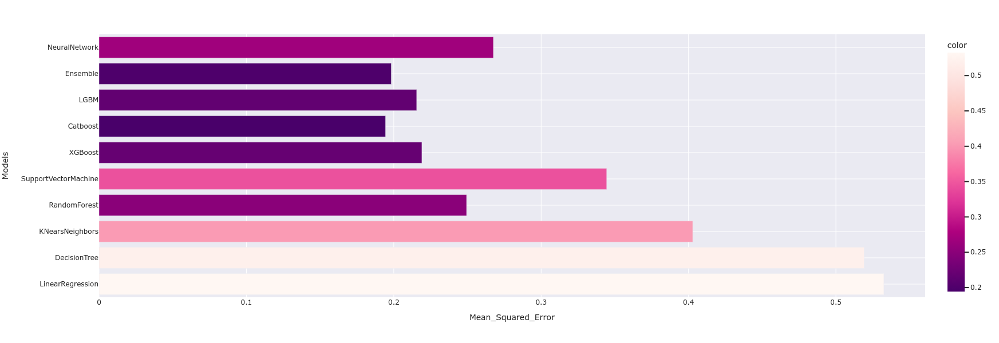

In [61]:
fig = px.bar(
    x=results.iloc[:10, 0].values,
    y=models,
    orientation='h',
    color=results['Mean_Squared_Error'].iloc[:10],
    color_continuous_scale='rdpu_r',  
    template="seaborn"
)

fig.update_layout(width=800, height=600,
                 xaxis=dict(title='Mean_Squared_Error'),
                 yaxis=dict(title="Models"))

fig.show()

#### Root Mean Squared Error

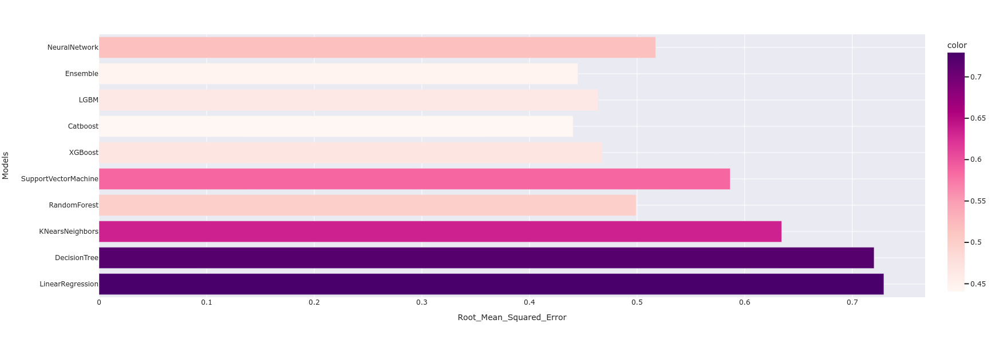

In [62]:
fig = px.bar(
    x=results.iloc[:10, 1].values,
    y=models,
    orientation='h',
    color=results['Root_Mean_Squared_Error'].iloc[:10],
    color_continuous_scale='rdpu',  
    template="seaborn"
)

fig.update_layout(width=800, height=600,
                 xaxis=dict(title='Root_Mean_Squared_Error'),
                 yaxis=dict(title="Models"))

fig.show()

#### R Squared

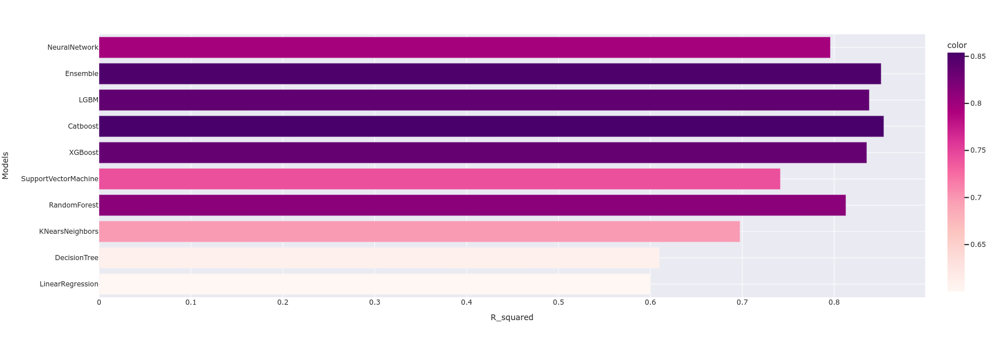

In [63]:
fig = px.bar(
    x=results.iloc[:10, 2].values,
    y=models,
    orientation='h',
    color=results['R_squared'].iloc[:10],
    color_continuous_scale='rdpu',  
    template="seaborn"
)

fig.update_layout(width=800, height=600,
                 xaxis=dict(title='R_squared'),
                 yaxis=dict(title="Models"))

fig.show()

#### Mean Absolute Error

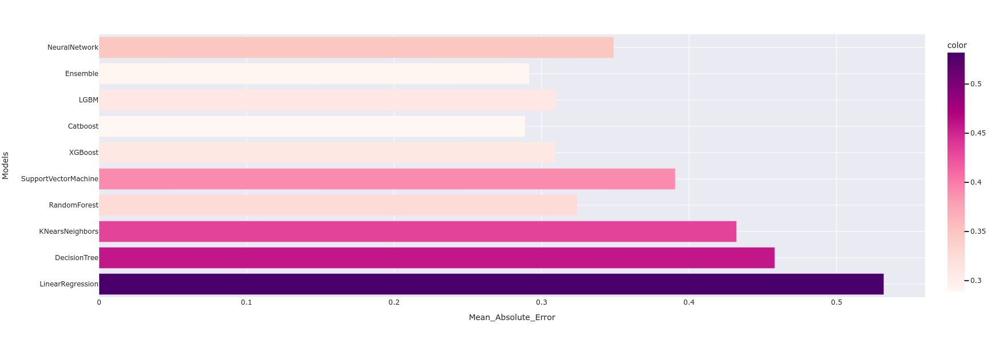

In [64]:
fig = px.bar(
    x=results.iloc[:10, 3].values,
    y=models,
    orientation='h',
    color=results['Mean_Absolute_Error'].iloc[:10],
    color_continuous_scale='rdpu',  
    template="seaborn"
)

fig.update_layout(width=800, height=600,
                 xaxis=dict(title='Mean_Absolute_Error'),
                 yaxis=dict(title="Models"))

fig.show()

#### Adjusted R Squared

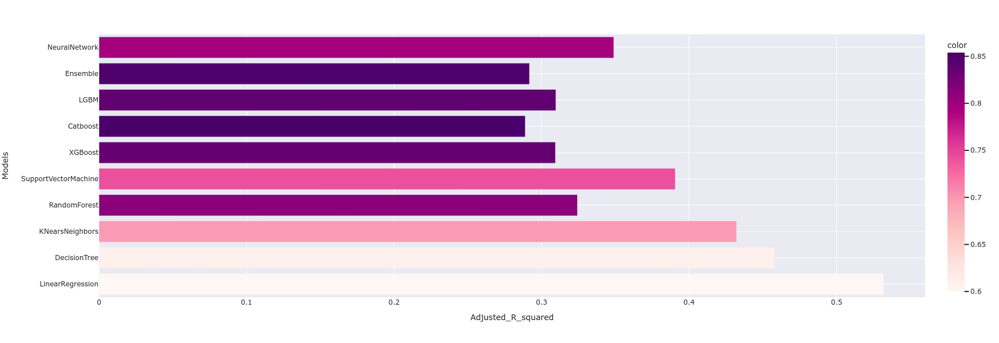

In [65]:
fig = px.bar(
    x=results.iloc[:10, 3].values,
    y=models,
    orientation='h',
    color=results['Adjusted_R_squared'].iloc[:10],
    color_continuous_scale='rdpu',  
    template="seaborn"
)

fig.update_layout(width=800, height=600,
                 xaxis=dict(title='Adjusted_R_squared'),
                 yaxis=dict(title="Models"))

fig.show()